In [2]:
using Plots, DifferentialEquations, LaTeXStrings, Plots.PlotMeasures, LinearAlgebra, CSV, DataFrames,ImplicitPlots,ForwardDiff
using BifurcationKit, Parameters, Setfield, Plots, Random
const BK = BifurcationKit;


In [152]:
function WTA_bif!(u,p)#time derivative,state,parameters,time
    τ = p[1]#time constant 
    
    K=p[2]

    k=p[3]
    
    E1 = u[1]#1st state variable
    E2 = u[2]#2nd state variable
    E3 = u[3]#3rd state variable

    S(x) = x >= 0 ? 100*x^2 / (40^2 + x^2) : 0.0

    [
    1/τ*(-E1 + S(K-k*E2-k*E3)),#system representation
    1/τ*(-E2 + S(K-k*E1-k*E3)),
    1/τ*(-E3 + S(K-k*E2-k*E1)),

    
    ]
    
end



WTA_bif! (generic function with 1 method)

In [153]:
τ=1.
K=0.
k=5.
p=(τ=τ,K=K,k=k)
x0=zeros(Float64, 3)
x0[1]=x0[2]=1.
rfs(x,p)=(E1=x[1])
prob = BifurcationProblem(WTA_bif!, x0, p, (@lens _.K),
                          record_from_solution = rfs)


┌─ Bifurcation Problem with uType Vector{Float64}
├─ Inplace:  false
├─ Symmetric: false
└─ Parameter: K

In [154]:
opts = ContinuationPar(p_min = 0., p_max = 20., n_inversion = 4,
                       ds = 0.001, dsmin = 0.0001, dsmax = 0.01, max_steps = 1000,
                       nev = 5)
display(opts)
br = continuation(prob, PALC(), opts; normC = BifurcationKit.norminf, bothside = true)


ContinuationPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  dsmin: Float64 0.0001
  dsmax: Float64 0.01
  ds: Float64 0.001
  a: Float64 0.5
  p_min: Float64 0.0
  p_max: Float64 20.0
  max_steps: Int64 1000
  newton_options: NewtonPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  η: Float64 150.0
  save_to_file: Bool false
  save_sol_every_step: Int64 1
  nev: Int64 5
  save_eig_every_step: Int64 1
  save_eigenvectors: Bool true
  plot_every_step: Int64 10
  tol_stability: Float64 1.0e-10
  detect_fold: Bool true
  detect_bifurcation: Int64 3
  dsmin_bisection: Float64 1.0e-16
  n_inversion: Int64 4
  max_bisection_steps: Int64 15
  tol_bisection_eigenvalue: Float64 1.0e-16
  detect_event: Int64 0
  tol_param_bisection_event: Float64 1.0e-16
  detect_loop: Bool false


 ┌─ Curve type: EquilibriumCont
 ├─ Number of points: 1003
 ├─ Type of vectors: Vector{Float64}
 ├─ Parameter K starts at 0.0, ends at 14.041348438765343
 ├─ Algo: PALC
 └─ Special points:

If `br` is the name of the branch,
ind_ev = index of the bifurcating eigenvalue e.g. `br.eig[idx].eigenvals[ind_ev]`

- #  1, endpoint at K ≈ +0.00000000,                                                                     step =   0
- #  2,       nd at K ≈ +3.21289939 ∈ (+3.21289853, +3.21289939), |δp|=9e-07, [converged], δ = ( 2,  0), step = 234, eigenelements in eig[235], ind_ev =   2
- #  3, endpoint at K ≈ +14.05544195,                                                                     step = 1003



──> BS from Non simple branch point
──> we find 4 (resp. 4) roots before (resp. after) the bifurcation point counting the trivial solution (Reduced equation).
──▶ Looking for solutions after the bifurcation point...
──▶ Looking for solutions before the bifurcation point...
──▶ we find 2 (resp. 1) roots after (resp. before) the bifurcation point.
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━


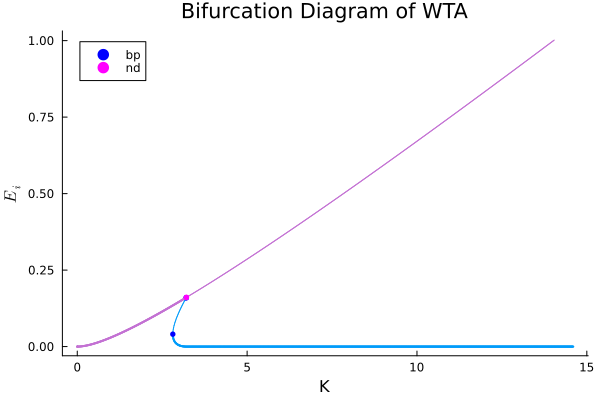

In [155]:
diagram = bifurcationdiagram(prob, br, 2, (args...) -> opts)
plot(diagram, grid = false, legend = :topleft)
title!("Bifurcation Diagram of WTA")
ylabel!(L"E_i")

In [156]:
savefig("BifurcationDiagram.pdf")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\BifurcationDiagram.pdf"

Fixing initial conditions

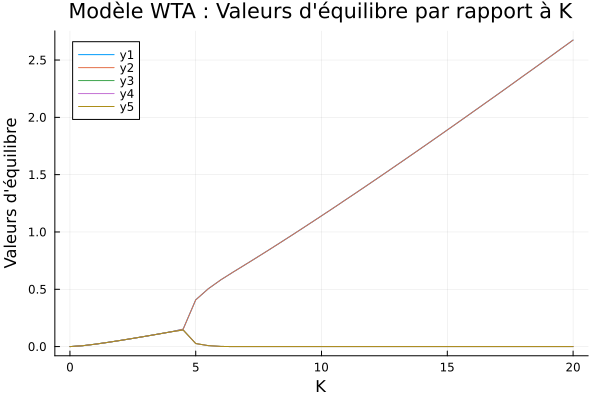

In [157]:
using DifferentialEquations
using Plots

# Définir la fonction WTA pour 20 neurones
function WTA!(du, u, p, t)
    τ = p[1]
    K = p[2]
    k = p[3]
    N = length(u)  # Nombre de neurones
    S(x) = x >= 0 ? 100x^2 / (40^2 + x^2) : 0.0

    for i in 1:N
        sum_excitation = sum(u[j] for j in 1:N if j != i)
        du[i] = 1/τ * (-u[i] + S(K - k * sum_excitation))
    end
end

# Fonction pour simuler le modèle WTA pour un certain K
function simulate_wta(K)
    τ = 1.0
    k = 5.
    N = 20  # Nombre de neurones
    u0 = zeros(5)  # État initial
    for i in 1:2
        u0[i] = 0.1
    end

    p = [τ, K, k]  # Paramètres
    tspan = (0.0, 100.0)  # Plage de temps pour la simulation

    prob = ODEProblem(WTA!, u0, tspan, p)
    sol = solve(prob, Tsit5())

    return sol[end]  # Retourne les valeurs d'équilibre
end

# Créer un tableau de valeurs de K
K_values = 0:0.5:20

# Simuler le modèle WTA pour chaque valeur de K
equilibrium_values = [simulate_wta(K) for K in K_values]

# Plotter les valeurs d'équilibre par rapport à K
plot(K_values, hcat(equilibrium_values...)', xlabel="K", ylabel="Valeurs d'équilibre", title="Modèle WTA : Valeurs d'équilibre par rapport à K")


In [158]:
savefig("WTAsimu")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\WTAsimu.png"

Taking random IC

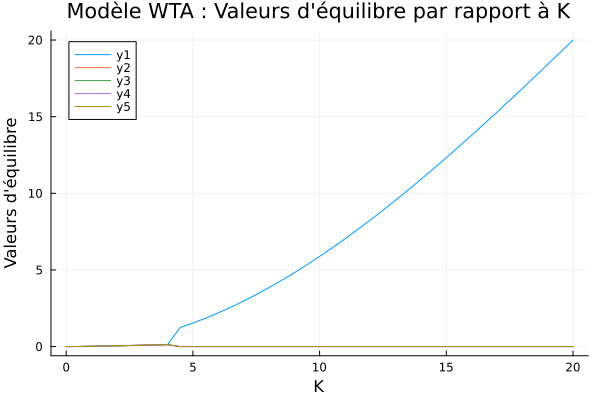

In [159]:
using DifferentialEquations
using Plots

# Définir la fonction WTA pour 20 neurones
function WTA!(du, u, p, t)
    τ = p[1]
    K = p[2]
    k = p[3]
    N = length(u)  # Nombre de neurones
    S(x) = x >= 0 ? 100x^2 / (40^2 + x^2) : 0.0

    for i in 1:N
        sum_excitation = sum(u[j] for j in 1:N if j != i)
        du[i] = 1/τ * (-u[i] + S(K - k * sum_excitation))
    end
end
N=5
u0 = zeros(N)  # État initial
    for i in 1:N
        u0[i] =rand()
    end

flag=false
# Fonction pour simuler le modèle WTA pour un certain K
function simulate_wta(K)
    τ = 1.0
    k = 5.
    N = 20  # Nombre de neurones


    p = [τ, K, k]  # Paramètres
    tspan = (0.0, 100.0)  # Plage de temps pour la simulation

    prob = ODEProblem(WTA!, u0, tspan, p)
    sol = solve(prob, Tsit5())
    
    return sol[end]  # Retourne les valeurs d'équilibre
end

# Créer un tableau de valeurs de K
K_values = 0:0.5:20


# Simuler le modèle WTA pour chaque valeur de K

equilibrium_values = [simulate_wta(K) for K in K_values]
# Plotter les valeurs d'équilibre par rapport à K
plot(K_values, hcat(equilibrium_values...)', xlabel="K", ylabel="Valeurs d'équilibre", title="Modèle WTA : Valeurs d'équilibre par rapport à K")


In [160]:
savefig("WTArandom")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\WTArandom.png"

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000


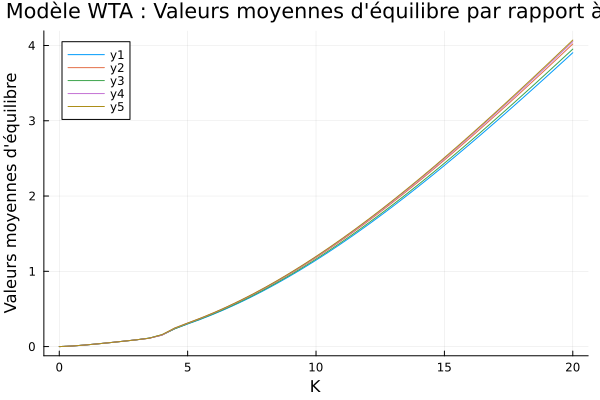

In [161]:
using DifferentialEquations
using Plots
using Statistics

# Définir la fonction WTA pour 20 neurones
function WTA!(du, u, p, t)
    τ = p[1]
    K = p[2]
    k = p[3]
    N = length(u)  # Nombre de neurones
    S(x) = x >= 0 ? 100x^2 / (40^2 + x^2) : 0.0

    for i in 1:N
        sum_excitation = sum(u[j] for j in 1:N if j != i)
        du[i] = 1/τ * (-u[i] + S(K - k * sum_excitation))
    end
end

# Fonction pour simuler le modèle WTA pour un certain K
function simulate_wta(K, u0)
    τ = 1.0
    k = 5.
    N = 5  # Nombre de neurones

    p = [τ, K, k]  # Paramètres
    tspan = (0.0, 100.0)  # Plage de temps pour la simulation

    prob = ODEProblem(WTA!, u0, tspan, p)
    sol = solve(prob, Tsit5())
    
    return sol[end]  # Retourne les valeurs d'équilibre
end

# Nombre de simulations à effectuer
N_simulations = 10000
N=5
# Créer un tableau de valeurs de K
K_values = 0:0.5:20

# Tableau pour stocker les résultats de chaque simulation
results = zeros(N_simulations, 41, N )
  # Imprimer la première ligne de chaque colonne


# Effectuer N_simulations simulations
for i in 1:N_simulations
    # Générer un nouvel état initial u0
    u0 = [rand() for _ in 1:N]
    
    # Simuler le modèle WTA pour chaque valeur de K
    equilibrium_values = [simulate_wta(K, u0) for K in K_values]
    equilibrium_matrix = hcat(equilibrium_values...)'
    
    # Ajouter les résultats de cette simulation au tableau des résultats
    for j in 1:41
        for k in 1:N
            results[i,j,k]=equilibrium_matrix[j,k]
        end
    end
    if((i%1000==0))
        println(i)
    end
    
end


values_to_plot=zeros(41,N)

for j in 1:41
    for k in 1:N
        number = 0.0  # Initialisation de number
        for i in 1:N_simulations  # Utilisation de `in` pour la boucle `for`
            number += results[i, j, k]
        end
        number /= N_simulations
        values_to_plot[j, k] = number
    end
end

        
            
# Plotter les valeurs moyennes d'équilibre par rapport à K
plot(K_values, values_to_plot, xlabel="K", ylabel="Valeurs moyennes d'équilibre", title="Modèle WTA : Valeurs moyennes d'équilibre par rapport à K")


In [162]:
savefig("WTAaverage")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\WTAaverage.png"

In [163]:
x=[[1,2],[3,4]]
println(x[1,1])

[1, 2]


4.266
[3.0608301765003108e-6, 3.060894368122668e-6, 3.0608302387178682e-6, 1.1242977883427137, 3.060829648097089e-6]
[-1.0, -1.0, -1.0, -1.0, -1.0]


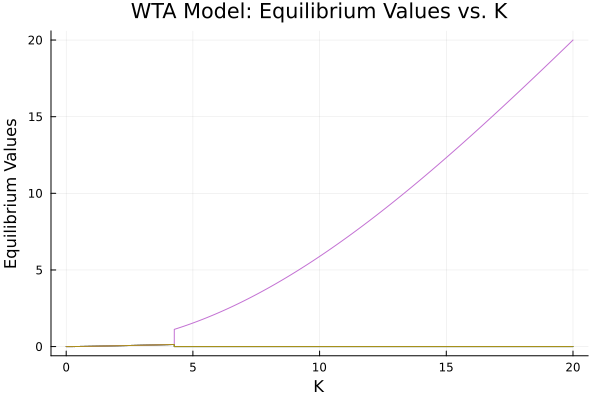

In [3]:
using DifferentialEquations
using Plots
using ForwardDiff
function WTA_jacobian(E,K)#this function will help to define the jacobian of the system
    S(x) = x >= 0 ? 100x^2 / (40^2 + x^2) : 0.0
    
    f1 = -E[1] + S(K - 5E[2] - 5E[3]-5E[4]-5E[5])
    f2 =  -E[2] + S(K - 5E[1] - 5E[3]-5E[4]-5E[5])
    f3 = -E[3] + S(K - 5E[1] - 5E[2]-5E[4]-5E[5])
    f4= -E[4] +S(K - 5E[1] - 5E[2]-5E[3]-5E[5])    
    f5=-E[5]+S(K - 5E[1] - 5E[2]-5E[3]-5E[4])
    
    return [f1,f2,f3,f4,f5]
end
# Define the function WTA for5 neurons
function WTA!(du, u, p, t)
    τ, K, k = p  # Unpack parameters
    N = length(u)  # Number of neurons
    S(x) = x >= 0 ? 100x^2 / (40^2 + x^2) : 0.0

    for i in 1:N
        sum_excitation = sum(u[j] for j in 1:N if j != i)
        du[i] = 1/τ * (-u[i] + S(K - k * sum_excitation))
    end
end

# Function to calculate the equilibrium values for a given K
function simulate_wta(K)
    τ = 1.0
    k = 5.0
    N = 5  # Number of neurons

    p = [τ, K, k]  # Parameters
    tspan = (0.0, 100.0)  # Time span for simulation

    prob = ODEProblem(WTA!, u0, tspan, p)
    sol = solve(prob, Tsit5())

    return sol[end]  # Return equilibrium values
end

# Define initial conditions
N = 5
u0 = rand(N)


# Create an array of K values
K_values = 0:0.001:20

# Simulate the WTA model for each K value
equilibrium_values = [simulate_wta(K) for K in K_values]
K=5.
# Find bifurcation points
bifurcation_points = []
sol = simulate_wta(K)
flag=0
J = ForwardDiff.jacobian(E -> WTA_jacobian(E, K), sol)


for (i, K) in enumerate(K_values)
    sol = simulate_wta(K)
    J = ForwardDiff.jacobian(E -> WTA_jacobian(E, K), sol)
    λ = eigvals(J)
    flag==0
    
    if (sol[1]>1. ||sol[2]>1. || sol[3]>1. || sol[4]>1. || sol[5]>1) && flag==0
        println(K)
        println(sol)
        println(λ)
        flag=1
    end
    
    
        
end


plot(K_values, hcat(equilibrium_values...)', xlabel="K", ylabel="Equilibrium Values", title="WTA Model: Equilibrium Values vs. K", legend=false)


scatter!(bifurcation_points, zeros(length(bifurcation_points)), markersize=5, color=:red, label="Bifurcation Points")


[-19.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694, -9.07299986662694]

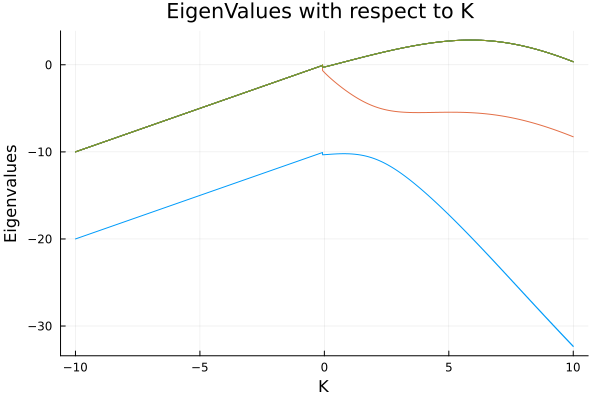

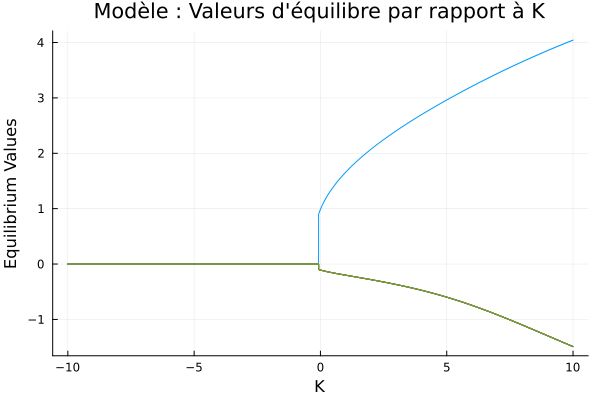

In [8]:
using DifferentialEquations
using Plots
using ForwardDiff

function sys!(du, u, p, t)
    N = length(u)
    k = p[1]
    for i in 1:N
        du[i] = k * u[i] - sum(u) + u[i]^2 - u[i]^3
    end
end

function Jacobian_sys(E, k)
    N = length(E)
    J = zeros(N, N)
    for i in 1:N
        for j in 1:N
            if i == j
                J[i, j] = k - 1 + 2 * E[i] - 3 * E[i]^2
            else
                J[i, j] = -1
            end
        end
    end
    return J
end

function simulate_sys(k)
    p = [k]  # Paramètres
    tspan = (0.0, 100.0)  # Plage de temps pour la simulation
    prob = ODEProblem(sys!, u0, tspan, p)
    sol = solve(prob, Tsit5())
    equilibrium = sol[end]  # Points d'équilibre
    J = Jacobian_sys(equilibrium, k)  # Calculer le jacobien à l'équilibre
    λ = eigvals(J)
    return equilibrium, λ
end

# Créer un tableau de valeurs de K
K_values = -10:0.001:10

# Définir les conditions initiales
u0 = zeros(10)
u0[1]=0.1


# Simuler le système pour chaque valeur de K et collecter les valeurs d'équilibre et les valeurs propres
equilibrium_values = []
eigenvalues = []
for k in K_values
    equilibrium, λ = simulate_sys(k)
    push!(equilibrium_values, equilibrium)
    push!(eigenvalues, λ)
    
end
print(eigenvalues[928])
# Plotter les valeurs d'équilibre par rapport à K
plot1 = plot(K_values, hcat(equilibrium_values...)', xlabel="K", ylabel="Equilibrium Values", title="Modèle : Valeurs d'équilibre par rapport à K", legend=false)

# Plotter les valeurs propres par rapport à K
eigen_real = real.(hcat(eigenvalues...)')
plot2 = plot(K_values, eigen_real, xlabel="K", ylabel="Eigenvalues", title="EigenValues with respect to K ", legend=false)

# Afficher les deux graphiques
display(plot2)
display(plot1)


In [166]:
savefig("sysbookeqnew")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\sysbookeqnew.png"

In [167]:
function sys!(u,p)#time derivative,state,parameters,time
    k = p[2]#time constant 
    
    [
        k*u[1] - sum(u) + u[1]^2 - u[1]^3,
        k*u[2] - sum(u) + u[2]^2 - u[2]^3,
        k*u[3] - sum(u) + u[3]^2 - u[3]^3,
    ]
    
end



sys! (generic function with 3 methods)

In [168]:

k=0.
p=(K=2, k=k)
x0=zeros(Float64, 3)
x0[1]=x0[2]=1.
rfs(x,p)=(E1=x[1],E2=x[2],E3=x[3])
prob = BifurcationProblem(sys!, x0, p, (@lens _.k),
                          record_from_solution = rfs)


┌─ Bifurcation Problem with uType Vector{Float64}
├─ Inplace:  false
├─ Symmetric: false
└─ Parameter: k

In [169]:
opts = ContinuationPar(p_min = -1., p_max = 10., n_inversion = 4,
                       ds = 0.001, dsmin = 0.0001, dsmax = 0.01, max_steps = 1000,
                       nev = 5)
display(opts)
br = continuation(prob, PALC(), opts; normC = BifurcationKit.norminf, bothside = true)


ContinuationPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  dsmin: Float64 0.0001
  dsmax: Float64 0.01
  ds: Float64 0.001
  a: Float64 0.5
  p_min: Float64 -1.0
  p_max: Float64 10.0
  max_steps: Int64 1000
  newton_options: NewtonPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  η: Float64 150.0
  save_to_file: Bool false
  save_sol_every_step: Int64 1
  nev: Int64 5
  save_eig_every_step: Int64 1
  save_eigenvectors: Bool true
  plot_every_step: Int64 10
  tol_stability: Float64 1.0e-10
  detect_fold: Bool true
  detect_bifurcation: Int64 3
  dsmin_bisection: Float64 1.0e-16
  n_inversion: Int64 4
  max_bisection_steps: Int64 15
  tol_bisection_eigenvalue: Float64 1.0e-16
  detect_event: Int64 0
  tol_param_bisection_event: Float64 1.0e-16
  detect_loop: Bool false


 ┌─ Curve type: EquilibriumCont
 ├─ Number of points: 789
 ├─ Type of vectors: Vector{Float64}
 ├─ Parameter k starts at -1.0, ends at 10.0
 ├─ Algo: PALC
 └─ Special points:

If `br` is the name of the branch,
ind_ev = index of the bifurcating eigenvalue e.g. `br.eig[idx].eigenvals[ind_ev]`

- #  1, endpoint at k ≈ -1.00000000,                                                                     step =   0
- #  2,       nd at k ≈ -0.00000061 ∈ (-0.00000061, +0.00000705), |δp|=8e-06, [converged], δ = ( 2,  0), step =  74, eigenelements in eig[ 75], ind_ev =   2
- #  3,       nd at k ≈ +0.00000168 ∈ (-0.00000598, +0.00000168), |δp|=8e-06, [converged], δ = ( 2,  0), step =  77, eigenelements in eig[ 78], ind_ev =   2
- #  4,       bp at k ≈ +3.00001463 ∈ (+2.99998701, +3.00001463), |δp|=3e-05, [converged], δ = ( 1,  0), step = 293, eigenelements in eig[294], ind_ev =   3
- #  5, endpoint at k ≈ +10.00000000,                                                                     step = 788



──> BS from Non simple branch point
──> we find 4 (resp. 4) roots before (resp. after) the bifurcation point counting the trivial solution (Reduced equation).
──▶ Looking for solutions after the bifurcation point...
──▶ Looking for solutions before the bifurcation point...
──▶ we find 4 (resp. 4) roots after (resp. before) the bifurcation point.
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

──> BS from Non simple branch point
──> we find 4 (resp. 4) roots before (resp. after) the bifurcation point counting the trivial solution (Reduced equation).
──▶ Looking for solutions after the bifurcation point...
──▶ Looking for solutions before the bifurcation point...
──▶ we find 4 (resp. 4) roots after (resp. before) the bifurcation poi

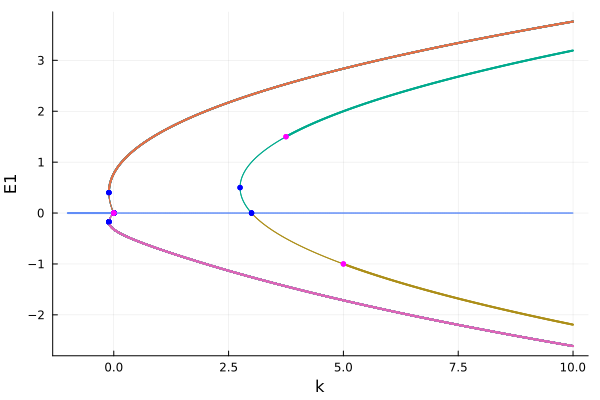

In [170]:
diagram = bifurcationdiagram(prob,br,2,(args...) -> opts)
plot(diagram,legend=false)

In [171]:
savefig("finalfig")

"C:\\Users\\Florent Boxus\\Documents\\master1\\Q2\\Brain inspired computing\\Project\\finalfig.png"